Training and testing the model for block 1

In [103]:
# Import the necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import os
import scipy.misc
from scipy import ndimage
import xml
import xml.etree.ElementTree as ET
import cv2
from PIL import Image
from skimage.transform import resize
import tqdm
from varname import nameof
import warnings
from sklearn.model_selection import train_test_split

In [104]:
# preproecssing .py files
# step 1
from extract_midpoints import extracting_midpoints_vimages, extracting_midpoints_himages
# step 2
from images_to_np_arrays import images_to_nparrays_vertical, images_to_nparrays_horizontal
# step 3
from create_dense_maps import creating_density_maps_v, creating_density_maps_h, creating_density_maps_na

from subwindows_and_counts import create_subwindows_and_counts

In [105]:
# Get all the data that belongs to block0101 together

# Where is data?

# Location for block0101 images and xml files
image_xml_01_file_path = "/common/statsgeneral/gayara/Schnable_lab_data/Images/Images_with_annotation/Block 101 - 106"

# get the names of all the files here
files_list_01 = os.listdir(image_xml_01_file_path)

# We need the images and xml files for 0101
files_list_0101 = [file for file in files_list_01 if file.split('_')[0][-4:] == '0101']

# how many files do we have here?
print("The number of files in files_list_0101: ", len(files_list_0101))

# from these some of the files are not annotated
# let's get the xml and the jpeg files separate
# xml files
xml_files_0101 = [i for i in files_list_0101 if i.split('.')[-1] == 'xml']
xml_files_0101.sort()
print("The number of xml files: ", len(xml_files_0101))
# jpeg files
jpeg_files_0101 = [i for i in files_list_0101 if i.split('.')[-1] == 'jpeg']
jpeg_files_0101.sort()
print("The number of image files: ", len(jpeg_files_0101))

# Note that 6 of the image files do not have annotations

# Some of the image files are vertical, and the other are horizontal
# vertical, not annotated images, these do not have a corresponding xml files
vertical_na_images = jpeg_files_0101[:6]

# vertical, annotated images, and the corresponding xml files
vertical_a_images = jpeg_files_0101[6:12]
vertical_a_xml = xml_files_0101[:6]

# horizontal, annotated images, and the corresponding xml files
horizontal_a_images = jpeg_files_0101[12:]
horizontal_a_xml = xml_files_0101[6:]


The number of files in files_list_0101:  54
The number of xml files:  24
The number of image files:  30


In [106]:
# Let's get the train and the test splits

# Train split
All_train_ims = [vertical_na_images[0], vertical_a_images[0], horizontal_a_images[1], horizontal_a_images[8], horizontal_a_images[15]]
All_train_xml = [fil.split('.')[0] + '.xml' for fil in All_train_ims if fil != vertical_na_images[0]]

# Test split
All_test_ims_intermediate = [file for file in jpeg_files_0101 if file not in All_train_ims]
All_test_xml_intermediate = [file for file in xml_files_0101 if file not in All_train_xml]

# But remove the files at the end here to be used in the VAR
All_test_ims = All_test_ims_intermediate[:-3]
All_test_xml = All_test_xml_intermediate[:-3]

# time series data
All_test_ims_ts = All_test_ims_intermediate[-3:]
All_test_xml_ts = All_test_xml_intermediate[-3:]

In [107]:
# Now it's about getting the model to train, and making predictions

In [108]:
# Need to first preprocess the train images - let's focu on the test images later


In [112]:
All_train_ims

['Block0101_2020_06_29.jpeg',
 'Block0101_2020_07_14.jpeg',
 'Block0101_2020_08_04.jpeg',
 'Block0101_2020_08_19.jpeg',
 'Block0101_2020_09_02.jpeg']

In [113]:
All_train_xml

['Block0101_2020_07_14.xml',
 'Block0101_2020_08_04.xml',
 'Block0101_2020_08_19.xml',
 'Block0101_2020_09_02.xml']

In [109]:
# Identify the annotated vertical, horizontal, and vertical not annotated images
# vertical images - annotated
vertical_train_ims = All_train_ims[1:2]
vertical_train_xml = All_train_xml[0:1]
# horizontal images - annotated
horizontal_train_ims = All_train_ims[-3:]
horizontal_train_xml = All_train_xml[-3:]
# vertical images - not annotated
vertical_train_ims_na = All_train_ims[0:1]

In [110]:
vertical_train_ims

['Block0101_2020_07_14.jpeg']

In [111]:
vertical_train_xml

['Block0101_2020_07_14.xml']

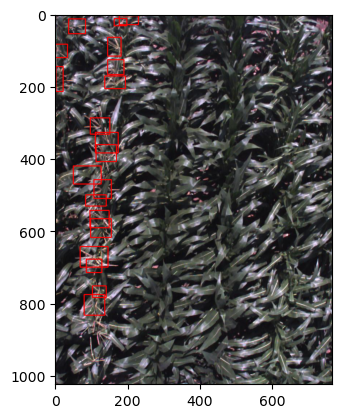

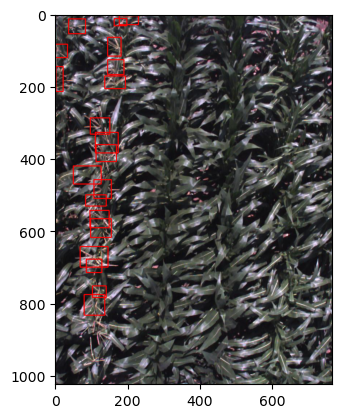

/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/create_dense_maps.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mid_coords.loc[mid_coords['mid_x'] > 768, 'mid_x'] = 767
/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/create_dense_maps.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mid_coords.loc[mid_coords['mid_y'] > 1024, 'mid_y'] = 1023


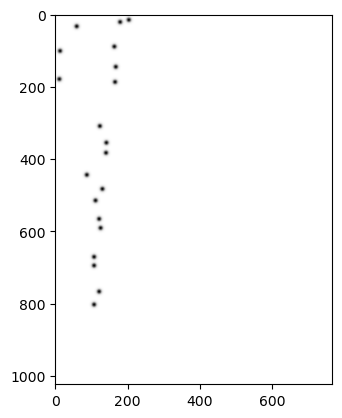

In [8]:
# 0101

# for va images
# step 1
# extract mid points
# store path for midpoints
store_path = '/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_dfs/'
midpoints_va = extracting_midpoints_vimages(image_xml_01_file_path, vertical_train_ims, vertical_train_xml,store_path)
# step 2
# convert the images to arrays
str_path = '/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays/Block01'
images_to_arrays = images_to_nparrays_vertical(image_xml_01_file_path, vertical_train_ims, str_path)
# step 3
# create the density maps
coords_df = midpoints_va[3]
dense_maps_va= creating_density_maps_v(vertical_train_ims, coords_df, str_path)
# step 4
# create the sub images (in np form) and densities
sub_wdws_and_dense = create_subwindows_and_counts(vertical_train_ims, str_path)

# save the npy files for later
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/' + nameof(vertical_train_ims).split('_')[0] + '_' + nameof(vertical_train_ims).split('_')[-1] + '_all_sub_windows.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense[0])
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/' + nameof(vertical_train_ims).split('_')[0] + '_' + nameof(vertical_train_ims).split('_')[-1]  + '_all_sub_counts.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense[1])



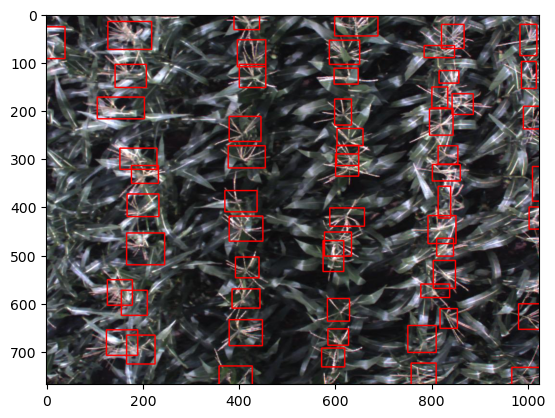

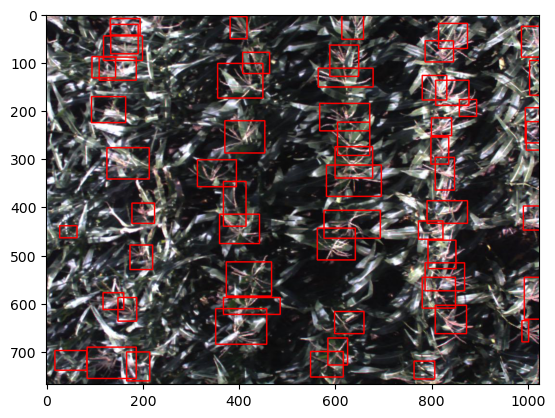

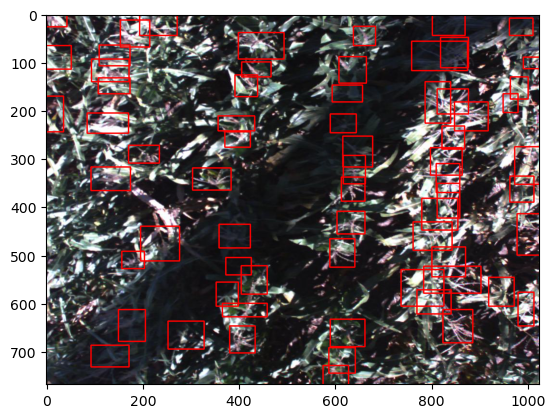

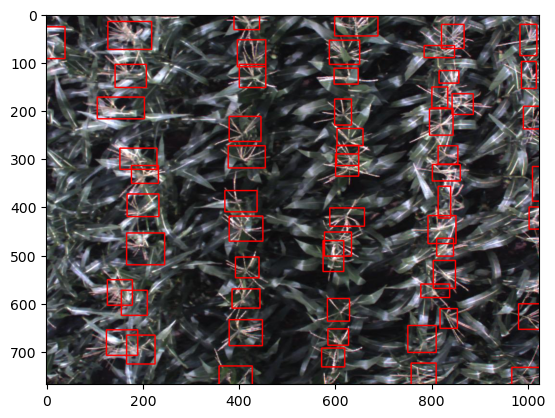

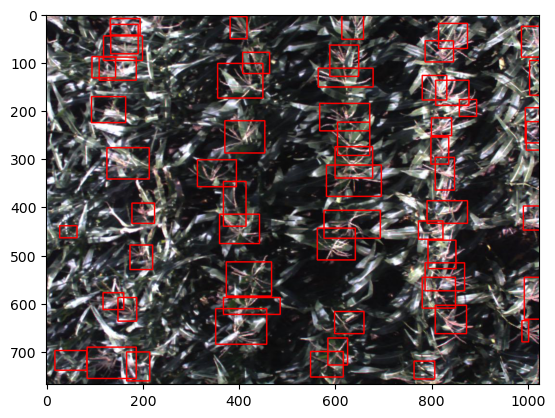

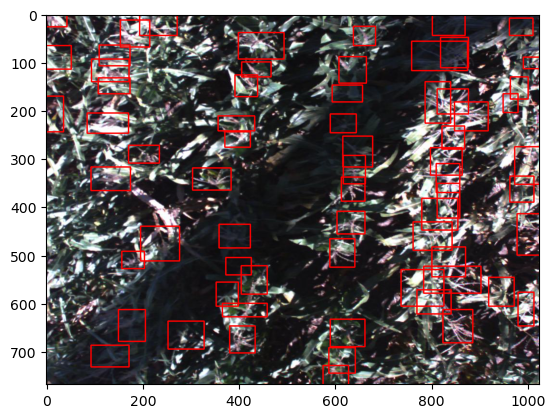

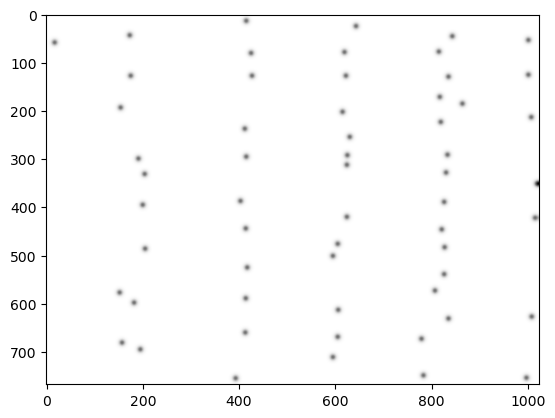

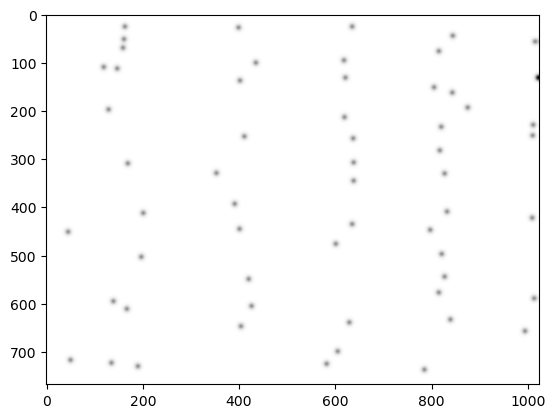

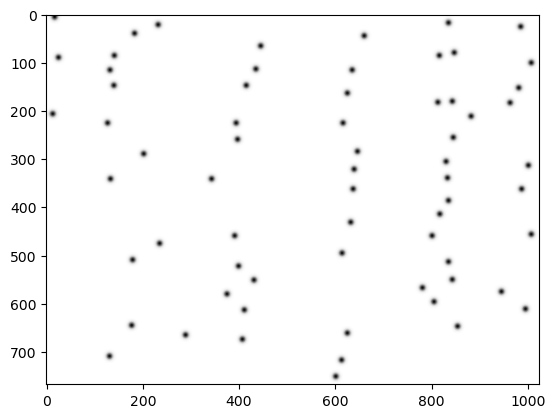

In [9]:
# for horzontal images
# extract mid points
store_path = '/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_dfs/'
midpoints_h = extracting_midpoints_himages(image_xml_01_file_path, horizontal_train_ims, horizontal_train_xml, store_path)
# convert the images to arrays
str_path = "/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays/Block01/"
images_to_arrays_h = images_to_nparrays_horizontal(image_xml_01_file_path, horizontal_train_ims, str_path)
# create the density maps
coords_df = midpoints_h[3]
dense_maps_h = creating_density_maps_h(horizontal_train_ims, coords_df, str_path)
# create the sub images (in np form) and densities
sub_wdws_and_dense_h = create_subwindows_and_counts(horizontal_train_ims, str_path)
# save the npy files for later
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/' + nameof(horizontal_train_ims).split('_')[0] + '_' + nameof(horizontal_train_ims).split('_')[-1] + '_all_sub_windows.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_h[0])
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/' + nameof(horizontal_train_ims).split('_')[0] + '_' + nameof(horizontal_train_ims).split('_')[-1]  + '_all_sub_counts.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_h[1])

In [10]:
# for vertical not annotated images
# convert the images to arrays
str_path = "/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays/Block01/"
images_to_arrays_vn = images_to_nparrays_vertical(image_xml_01_file_path, vertical_train_ims_na, str_path)
# create the density maps
dense_maps_vn = creating_density_maps_na(vertical_train_ims_na, str_path)
# create the sub images (in np form) and densities
sub_wdws_and_dense_vn = create_subwindows_and_counts(vertical_train_ims_na, str_path)

# save the npy files for later
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/' + nameof(vertical_train_ims_na).split('_')[0] + '_' + nameof(vertical_train_ims_na).split('_')[-1] + '_all_sub_windows.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_vn[0])
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/' + nameof(vertical_train_ims_na).split('_')[0] + '_' + nameof(vertical_train_ims_na).split('_')[-1]  + '_all_sub_counts.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_vn[1])

In [11]:
print(np.max(coords_df['mid_x']))
print(np.max(coords_df['mid_y']))

1022
756


In [12]:
# need to stack all these together  (separately for sub windows and counts to train the model)

# Need to also specify the validation data at this point - split the data to train and validation - for better training purposes

In [13]:
# check the sub windows
list_subs = os.listdir('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/')

In [14]:
list_subs.sort()
list_subs


['.ipynb_checkpoints',
 'horizontal_ims_all_sub_counts.npy',
 'horizontal_ims_all_sub_windows.npy',
 'vertical_ims_all_sub_counts.npy',
 'vertical_ims_all_sub_windows.npy',
 'vertical_na_all_sub_counts.npy',
 'vertical_na_all_sub_windows.npy']

In [15]:
# remove the checkpoints folder

list_subs = list_subs[1:]

In [19]:
# load these numpy files
loaded_files = []
for file in list_subs:
    load = np.load('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/' + file)
    loaded_files.append(load)

In [33]:
# try to randomly split the train and validation data here
load_path = "/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts/Block0101/"
# horizontal data
X_train_h, X_test_h, Y_train_h, Y_test_h = train_test_split(np.load(load_path + 'horizontal_ims_all_sub_windows.npy'), np.load(load_path + 'horizontal_ims_all_sub_counts.npy'),
                                                           random_state = 42, test_size = 0.25)
# vertical annotated data
X_train_va, X_test_va, Y_train_va, Y_test_va = train_test_split(np.load(load_path + 'vertical_ims_all_sub_windows.npy'), np.load(load_path + 'vertical_ims_all_sub_counts.npy'),
                                                           random_state = 42, test_size = 0.10)
# vertical not annotated data
X_train_vn, X_test_vn, Y_train_vn, Y_test_vn = train_test_split(np.load(load_path + 'vertical_na_all_sub_windows.npy'), np.load(load_path + 'vertical_na_all_sub_counts.npy'),
                                                           random_state = 42, test_size = 0.10)

In [ ]:
# Now, let's stack these together

In [53]:
# Train data
all_train_stack_X = np.vstack((X_train_vn, X_train_va, X_train_h))
print("X_train shape: ", all_train_stack_X.shape)
all_train_stack_Y = np.hstack((Y_train_vn, Y_train_va, Y_train_h))
print("Y_train shape: ", all_train_stack_Y.shape)

X_train shape:  (49766, 32, 32, 3)
Y_train shape:  (49766,)


In [54]:
# Validation data
all_valid_stack_X = np.vstack((X_test_vn, X_test_va, X_test_h))
print("X_valid shape: ", all_valid_stack_X.shape)
all_valid_stack_Y = np.hstack((Y_test_vn, Y_test_va, Y_test_h))
print("Y_valid shape: ", all_valid_stack_Y.shape)

X_valid shape:  (11674, 32, 32, 3)
Y_valid shape:  (11674,)


#### Training the model

In [55]:
# load the pretrained modedl
model = tf.keras.models.load_model('/home/statsgeneral/gayara/Tasselnet/Filtered_90/tasselnet1_overlapping_w32.h5')
# look at the input shape
model.input
    

2023-02-24 09:44:15.936461: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-24 09:44:17.367126: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1532] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 30965 MB memory:  -> device: 0, name: Tesla V100-PCIE-32GB, pci bus id: 0000:d8:00.0, compute capability: 7.0


<KerasTensor: shape=(None, 32, 32, 3) dtype=float32 (created by layer 'conv2d_input')>

In [56]:

# need to remove some of the last layers
output_trial = model.layers[-8].output
    
# create the functional API model
reduced_model = tf.keras.models.Model(model.input, output_trial)

# okay, now need to add back the dropout, the dense and activation

# add dropout
added_dropout = tf.keras.layers.Dropout(0.5, name = "New_dropout")(model.layers[-8].output)

# add flatten
added_flatten = tf.keras.layers.Flatten(name = "Flatten2")(added_dropout)

# add dense
added_dense = tf.keras.layers.Dense(512, name = "New_Dense")(added_flatten)

# add activation
added_Act = tf.keras.layers.Activation('relu', name = "New_Activation")(added_dense)

# add dropout
added_dropout2 = tf.keras.layers.Dropout(0.5, name = "New_dropout2")(added_Act)

# add dense
added_dense2 = tf.keras.layers.Dense(1, name = "New_Dense2")(added_dropout2)

# add activation
added_Act2 = tf.keras.layers.Activation('relu', name = "New_Activation2")(added_dense2)

# define the new model with functional API
new_model = tf.keras.models.Model(model.input, added_Act2)
    
#     freeze layers
for layer in model.layers:
    layer.trainable = False
    
# compile the model
opt = tf.keras.optimizers.Adam(learning_rate=0.001)
new_model.compile(loss='mean_squared_error', optimizer=opt, metrics = ['mean_absolute_error'])
    
# add early stopping
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', restore_best_weights = True, verbose=1, patience=10)

#     fit the frozen model:
history = new_model.fit(all_train_stack_X, all_train_stack_Y,
          epochs = 100, callbacks = [es],
          validation_data = (all_valid_stack_X, all_valid_stack_Y), 
                       batch_size = 500, validation_batch_size = 500)
    
    
    # # unfreeze few layers and retrain
model.trainable = True

set_trainable = False

for layer in model.layers:
    if layer.name == 'conv2d_3':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False
            
    # # compile the mdoel
opt = tf.keras.optimizers.Adam(learning_rate=0.001)
new_model.compile(loss='mean_squared_error', optimizer=opt, metrics = ['mean_absolute_error'])
    
    # # add early stopping
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', restore_best_weights = True, verbose=1, patience=10)
    
    # # fit the model (fine tuned)
history_new = new_model.fit(all_train_stack_X, all_train_stack_Y,
          epochs = 100, callbacks = [es],
          validation_data = (all_valid_stack_X, all_valid_stack_Y), 
                       batch_size = 500, validation_batch_size = 500)
    
    #     save the model
model_name = 'model_B0101_adjusted_for_splits.h5'
new_model.save('/common/statsgeneral/gayara/Schnable_lab_data/Models_for_VAR' + '/' + model_name)

Epoch 1/100


2023-02-24 09:45:19.432406: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8401


100/100 [==============================] - 5s 13ms/step - loss: 0.0287 - mean_absolute_error: 0.0674 - val_loss: 0.0365 - val_mean_absolute_error: 0.0776
Epoch 2/100
100/100 [==============================] - 1s 8ms/step - loss: 0.0273 - mean_absolute_error: 0.0636 - val_loss: 0.0365 - val_mean_absolute_error: 0.0729
Epoch 3/100
100/100 [==============================] - 1s 8ms/step - loss: 0.0270 - mean_absolute_error: 0.0624 - val_loss: 0.0361 - val_mean_absolute_error: 0.0738
Epoch 4/100
100/100 [==============================] - 1s 8ms/step - loss: 0.0266 - mean_absolute_error: 0.0629 - val_loss: 0.0357 - val_mean_absolute_error: 0.0746
Epoch 5/100
100/100 [==============================] - 1s 8ms/step - loss: 0.0262 - mean_absolute_error: 0.0616 - val_loss: 0.0355 - val_mean_absolute_error: 0.0735
Epoch 6/100
100/100 [==============================] - 1s 8ms/step - loss: 0.0260 - mean_absolute_error: 0.0609 - val_loss: 0.0355 - val_mean_absolute_error: 0.0731
Epoch 7/100
100/100 [

In [57]:
# Get the predictions for the test images

# Need to preprocess the test images too

In [64]:
# Split the hrizontal and vertical image data
# vertical images - annotated
vertical_test_ims = All_test_ims[5:10]
vertical_test_xml = All_test_xml[0:5]
for i in range(len(vertical_test_ims)):
    if vertical_test_ims[i].split('.')[0] == vertical_test_xml[i].split('.')[0]:
        print("True")
# horizontal images - annotated
horizontal_test_ims = All_test_ims[-12:]
horizontal_test_xml = All_test_xml[-12:]
for i in range(len(horizontal_test_ims)):
    if horizontal_test_ims[i].split('.')[0] == horizontal_test_xml[i].split('.')[0]:
        print("True")
# vertical images - not annotated
vertical_test_ims_na = All_test_ims[0:5]

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True


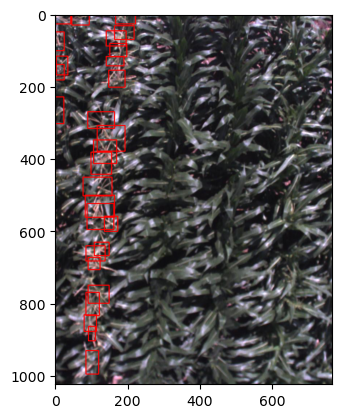

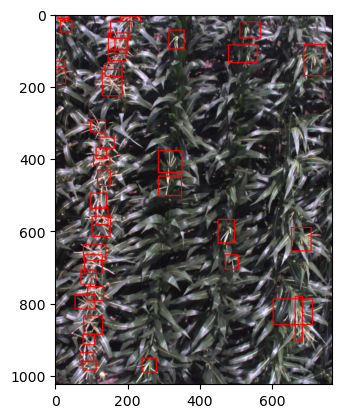

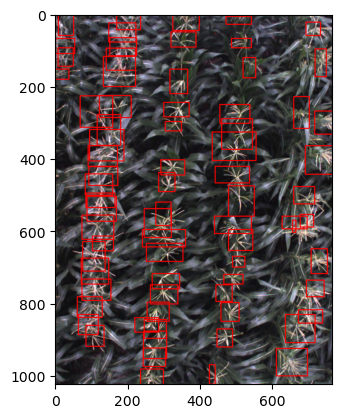

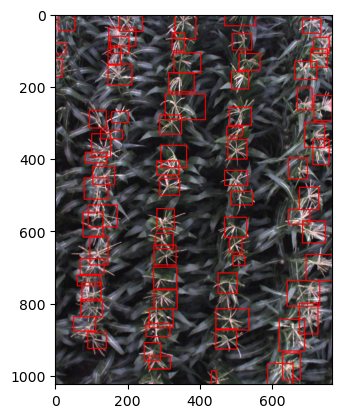

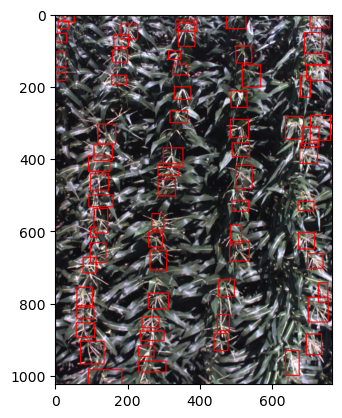

...

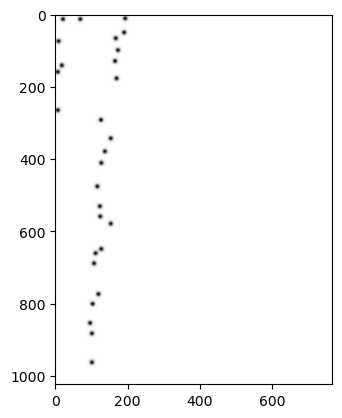

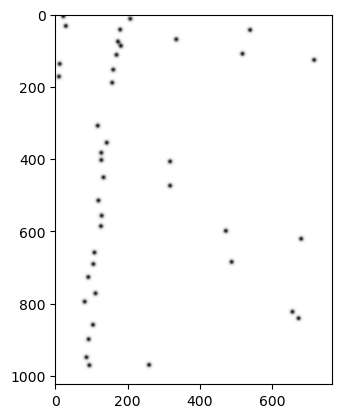

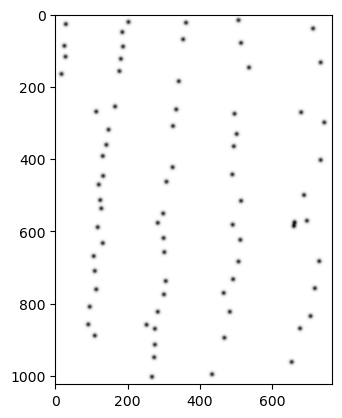

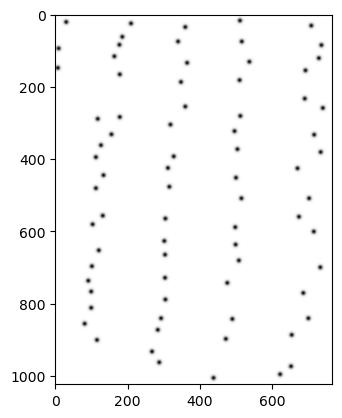

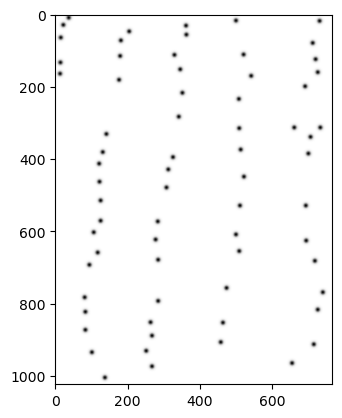

In [65]:

# for va images
# extract mid points
store_path = '/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_dfs/'
midpoints_va = extracting_midpoints_vimages(image_xml_01_file_path, vertical_test_ims, vertical_test_xml, store_path)
# convert the images to arrays
str_path = "/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays_test/Block0101/"
images_to_arrays_va = images_to_nparrays_vertical(image_xml_01_file_path, vertical_test_ims, str_path)
# create the density maps
coords_df = midpoints_va[3]
dense_maps_va = creating_density_maps_v(vertical_test_ims, coords_df, str_path)
# create the sub images (in np form) and densities
sub_wdws_and_dense = create_subwindows_and_counts(vertical_test_ims, str_path)

# save the npy files for later
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts_test/Block0101/' + nameof(vertical_test_ims).split('_')[0] + '_' + nameof(vertical_test_ims).split('_')[-1] + '_all_sub_windows.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense[0])
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts_test/Block0101/' + nameof(vertical_test_ims).split('_')[0] + '_' + nameof(vertical_test_ims).split('_')[-1]  + '_all_sub_counts.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense[1])

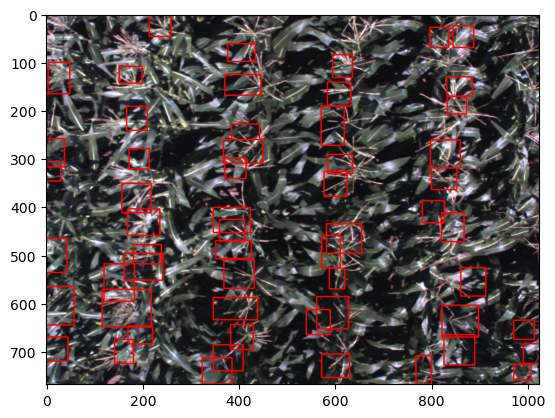

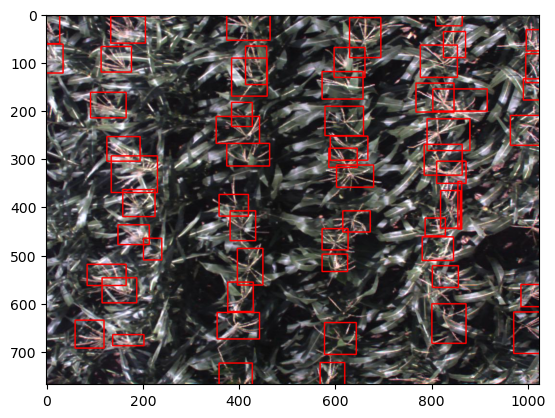

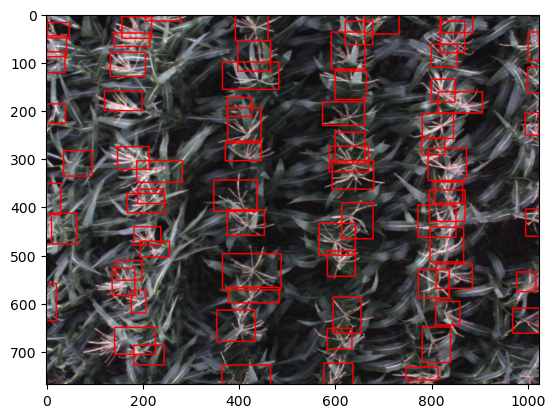

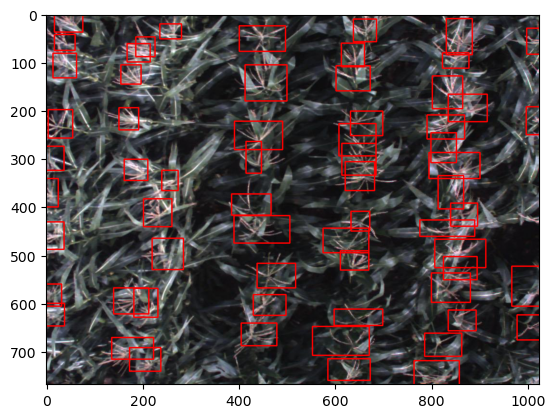

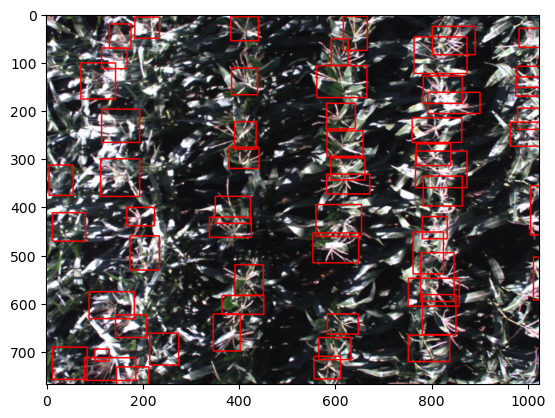

...

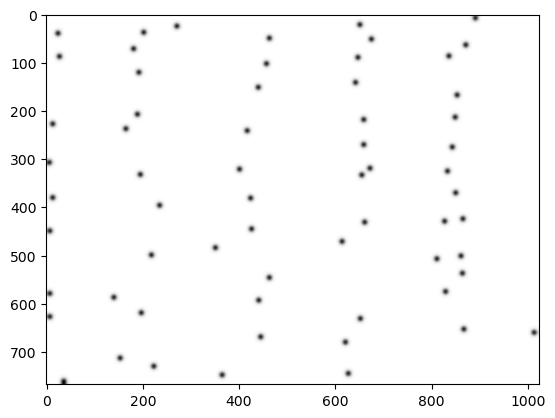

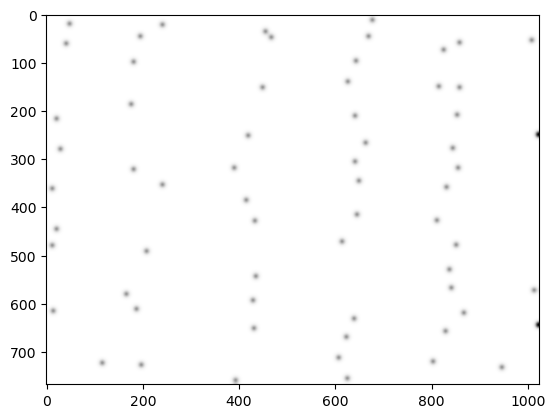

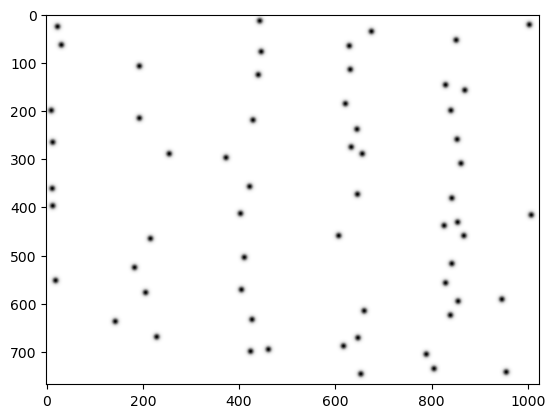

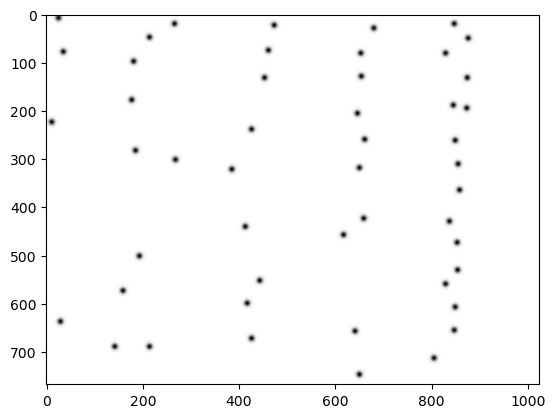

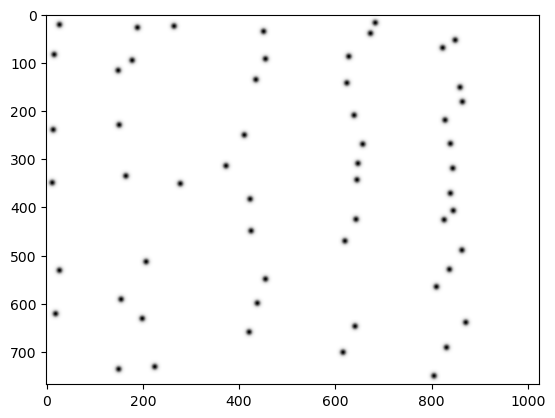

In [66]:
# for horzontal images
# extract mid points
store_path = '/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_dfs/'
midpoints_h= extracting_midpoints_himages(image_xml_01_file_path, horizontal_test_ims, horizontal_test_xml, store_path)
# convert the images to arrays
str_path = "/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays_test/Block0101/"
images_to_arrays = images_to_nparrays_horizontal(image_xml_01_file_path, horizontal_test_ims, str_path)
# create the density maps
coords_df = midpoints_h[3]
dense_maps_h = creating_density_maps_h(horizontal_test_ims, coords_df, str_path)
# create the sub images (in np form) and densities
sub_wdws_and_dense_h = create_subwindows_and_counts(horizontal_test_ims, str_path)
# save the npy files for later
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts_test/Block0101/' + nameof(horizontal_test_ims).split('_')[0] + '_' + nameof(horizontal_test_ims).split('_')[-1] + '_all_sub_windows.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_h[0])
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts_test/Block0101/' + nameof(horizontal_test_ims).split('_')[0] + '_' + nameof(horizontal_test_ims).split('_')[-1]  + '_all_sub_counts.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_h[1])



In [67]:
    
# for vn images
# convert the images to arrays
str_path = "/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays_test/Block0101/"
images_to_arrays_vn = images_to_nparrays_vertical(image_xml_01_file_path, vertical_test_ims_na, str_path)
# create the density maps
dense_maps_vn = creating_density_maps_na(vertical_test_ims_na, str_path)
# create the sub images (in np form) and densities
sub_wdws_and_dense_v = create_subwindows_and_counts(vertical_test_ims_na, str_path)

# save the npy files for later
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts_test/Block0101/' + nameof(vertical_test_ims_na).split('_')[0] + '_' + nameof(vertical_test_ims_na).split('_')[-1] + '_all_sub_windows.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_v[0])
with open('/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_sub_images_and_counts_test/Block0101/' + nameof(vertical_test_ims_na).split('_')[0] + '_' + nameof(vertical_test_ims_na).split('_')[-1]  + '_all_sub_counts.npy', 'wb') as f:
    np.save(f,sub_wdws_and_dense_v[1])

In [ ]:
# Now, we can get the predictions for all the test images

# How to od this?

# First need to stack the test files idividually

In [68]:
# names of the np files
numpy_folder = r"/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays_test/Block0101/"
test_files = os.listdir(numpy_folder)
test_files.sort()

In [70]:
# test_files

In [71]:
# test_files - how many are there?
image_test_files = []
for item in test_files:
    if item.split('_')[-1] == 'resized.npy':
        image_test_files.append(item)
        
len(image_test_files)

22

In [72]:
# get the subwindows in stacks, and store these - needs to be dne for each of the 22 files
def prediction_on_test_data(selected_file, stride = 8, kernel_size = 32):

# load the image data file
    load_image = np.load(numpy_folder  + selected_file)
    
    # append the subwindows together

    # get the subwindows
    sub_windows = []

    # get the image height
    img_height = load_image.shape[0]
    # get the image weight
    img_width = load_image.shape[1]

    for i in  range(0, img_height, stride):
        for j in range(0, img_width, stride):
            sub_window = load_image[i: i + kernel_size, j : j + kernel_size,:]
#             resize the sub window
            sub_window = resize(sub_window, (32,32,3))
    #     append the sub window images
            sub_windows.append((sub_window))

#         stack the subwindows together to pass to the predict function
    all_test_sub_windows = np.stack(sub_windows)
    
    return(all_test_sub_windows)

In [73]:
# save the files

store_test_np = r"/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_test_np_stacked/Block0101"
for test_file in image_test_files:
    np_file = prediction_on_test_data(test_file)
    np.save(store_test_np + "/" + test_file, np_file)

Get the predictions

In [74]:
# Function to get the predictions given model and image

numpy_folder = "/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_image_arrays_test/Block0101"
v_stack_folder = store_test_np

def prediction_on_test_data(model, selected_file, stride = 8, kernel_size = 32):
#     load the cnn model
    
# load the image data file
    load_image = np.load(numpy_folder + "/"+ selected_file)
    
    # get the image height
    img_height = load_image.shape[0]
    # get the image weight
    img_width = load_image.shape[1]

    all_test_sub_windows = np.load(v_stack_folder + "/"+ selected_file)

    # now, to get the predictions, pass the sub windows
    test_image_prediction = model.predict(all_test_sub_windows)
    
    # density map
    Density_map = np.zeros((img_height, img_width))

    # counts map
    counts_map = np.zeros((img_height, img_width))
    
    # now, for every window, we will keep adding the values together and also add the counts
    counter = 0
#     need a counter to move into each predicted value in the pred values list
    for ii in range(0, img_height, stride):
        for jj in range(0, img_width, stride):
#         operations for density map
#             get the window of interest
            new_window = Density_map[ii:ii + kernel_size,jj:jj+kernel_size]
#     fill each with the value c_k
            counts_window = np.full((new_window.shape[0], new_window.shape[1]), test_image_prediction[counter])
#     get the shapes of this new window
            cw_height = counts_window.shape[0]
            cw_width = counts_window.shape[1]
#         Do c_k/r_2
            counts_window_new = counts_window/(cw_height*cw_width)
#     This is the value in the window now
            value_window = counts_window_new
#     place the values in the corrsponding area of the density map
            Density_map[ii:ii + kernel_size,jj:jj+kernel_size] = new_window + value_window

#         Let's now focus on capturing the counts of the windows
            new_window_c = counts_map[ii:ii + kernel_size,jj:jj+kernel_size]
#     get the counts area
            count = np.ones((new_window_c.shape[0], new_window_c.shape[1]))
#     keep adding the counts to reflect the addition of densities
            counts_map[ii:ii + kernel_size,jj:jj+kernel_size] = new_window_c + count
#     increase the counter
            counter = counter + 1
            
#         get the normalized count
    normalized_counts = np.divide(Density_map, counts_map)
    
#     entire count on the test set
    pred_on_test = np.sum(normalized_counts)
    
#     return the predicted value
    return(pred_on_test, normalized_counts, selected_file)


In [75]:
all_preds_loop = []

for file in image_test_files:
    results = prediction_on_test_data(new_model, file)
    all_preds_loop.append(results)

384/384 [==============================] - 0s 1ms/step


In [76]:
# Extract the preds, image names, and density maps
all_dense_maps = []
all_preds = []
all_im_names = []
for i in all_preds_loop:
    pred = i[0]
    all_preds.append(pred)
    name = i[2]
    all_im_names.append(name)
    dense_map = i[1]
    all_dense_maps.append(dense_map)


In [77]:
predicted_counts_df = pd.DataFrame(list(zip(all_im_names, all_preds)), columns = ["Image_name", "Predicted_count"])

In [78]:
predicted_counts_df.head()

,Image_name,Predicted_count
0,Block0101_2020_07_01_resized.npy,10.150204
1,Block0101_2020_07_02_resized.npy,6.460820
2,Block0101_2020_07_06_resized.npy,4.633180
3,Block0101_2020_07_07_resized.npy,4.861442
4,Block0101_2020_07_08_resized.npy,5.917182


In [79]:
# import the true counts frro the test data
data_set_pat = '/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_dfs'

In [80]:
data_frames = os.listdir(data_set_pat)
data_frames

['Block0101_h_train_data.csv',
 'Block0101_v_train_data.csv',
 'Block0101_v_true_counts.csv',
 'Block0101_h_true_counts.csv']

In [81]:

# get the datasets that give the true test counts
test_true_dfs = []
for ds in data_frames:
    if ds.split('_')[-1] == 'counts.csv':
        test_true_dfs.append(ds)

In [82]:
# The needs to convert the list to a single dataframe
all_dfs = []
for df in test_true_dfs:
    df_imp = pd.read_csv("/common/statsgeneral/gayara/Schnable_lab_data/VAR_attempt/VAR_dfs/" + df)
    all_dfs.append(df_imp)

In [83]:
true_counts_df = pd.concat(all_dfs)

In [84]:
true_counts_df.head()

,Image_Name,True_count
0,Block0101_2020_07_16.jpeg,28
1,Block0101_2020_07_17.jpeg,40
2,Block0101_2020_07_20.jpeg,75
3,Block0101_2020_07_22.jpeg,76
4,Block0101_2020_07_23.jpeg,69


In [85]:
true_counts_df.shape

(17, 2)

In [86]:
# There seems to be a train test mismatch, but ignore this for now
# Let's only get the images common to both data frames
# And also take a look at the once those were not included - These might be the images with true counts 0


In [87]:
# true_counts_df['Image_name'] = [item.split('.')[0] + '_resized.npy' for item in true_counts_df["Image_Name"]]

In [88]:
# true_counts_df.head(10)

In [89]:
# true_counts_final = true_counts_df[["Image_name", "True_count"]]

In [90]:
# true_counts_final.head()

In [91]:
# pd.merge(df1, indexed_df2, left_on="key", right_index=True)

In [92]:
true_counts_df.columns = ['Image_name', 'True_Count']

In [93]:
true_counts_df.head()

,Image_name,True_Count
0,Block0101_2020_07_16.jpeg,28
1,Block0101_2020_07_17.jpeg,40
2,Block0101_2020_07_20.jpeg,75
3,Block0101_2020_07_22.jpeg,76
4,Block0101_2020_07_23.jpeg,69


In [94]:
true_counts_df['Image_name'] = [item.split('.')[0] + '_resized.npy' for item in true_counts_df["Image_name"]]

In [95]:
predicted_counts_df.head(10)

,Image_name,Predicted_count
0,Block0101_2020_07_01_resized.npy,10.150204
1,Block0101_2020_07_02_resized.npy,6.460820
2,Block0101_2020_07_06_resized.npy,4.633180
3,Block0101_2020_07_07_resized.npy,4.861442
4,Block0101_2020_07_08_resized.npy,5.917182
5,Block0101_2020_07_16_resized.npy,16.024325
6,Block0101_2020_07_17_resized.npy,26.627665
7,Block0101_2020_07_20_resized.npy,38.734614
8,Block0101_2020_07_22_resized.npy,49.556197
9,Block0101_2020_07_23_resized.npy,42.890720


In [96]:
merged_data = pd.merge(true_counts_df, predicted_counts_df, on = "Image_name", how = "right")

In [97]:
merged_data.shape

(22, 3)

In [98]:
merged_data.tail()

,Image_name,True_Count,Predicted_count
17,Block0101_2020_08_21_resized.npy,63.0,40.637514
18,Block0101_2020_08_25_resized.npy,64.0,40.308234
19,Block0101_2020_08_26_resized.npy,60.0,55.162323
20,Block0101_2020_08_27_resized.npy,49.0,52.850700
21,Block0101_2020_08_28_resized.npy,56.0,27.780483


In [99]:
merged_data = merged_data.fillna(0)

In [100]:
merged_data.head()

,Image_name,True_Count,Predicted_count
0,Block0101_2020_07_01_resized.npy,0.0,10.150204
1,Block0101_2020_07_02_resized.npy,0.0,6.460820
2,Block0101_2020_07_06_resized.npy,0.0,4.633180
3,Block0101_2020_07_07_resized.npy,0.0,4.861442
4,Block0101_2020_07_08_resized.npy,0.0,5.917182


In [101]:
# Compute the MAE
absolute_diff = abs(merged_data["True_Count"] - merged_data["Predicted_count"])
mae = np.mean(absolute_diff)
mae

16.416041472544155

In [102]:
merged_data

,Image_name,True_Count,Predicted_count
0,Block0101_2020_07_01_resized.npy,0.0,10.150204
1,Block0101_2020_07_02_resized.npy,0.0,6.460820
2,Block0101_2020_07_06_resized.npy,0.0,4.633180
3,Block0101_2020_07_07_resized.npy,0.0,4.861442
4,Block0101_2020_07_08_resized.npy,0.0,5.917182
5,Block0101_2020_07_16_resized.npy,28.0,16.024325
6,Block0101_2020_07_17_resized.npy,40.0,26.627665
7,Block0101_2020_07_20_resized.npy,75.0,38.734614
8,Block0101_2020_07_22_resized.npy,76.0,49.556197
9,Block0101_2020_07_23_resized.npy,69.0,42.890720


In [ ]:
# Plot some of the predicted files